In [1]:
import stt as st
import scanpy as sc
import anndata
import scvelo as scv

In [2]:
data_dir = '../data/emt_sim/'
adata = sc.read_h5ad(data_dir+'emt_circuit_larger_noise.h5ad')

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


In [3]:
adata

AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden'
    var: 'highly_variable', 'velocity_gamma'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap'
    obsm: 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


scVelo results

In [4]:
#scv.pp.moments(adata)
scv.tl.velocity(adata, mode = 'dynamical')
scv.tl.velocity_graph(adata)

computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


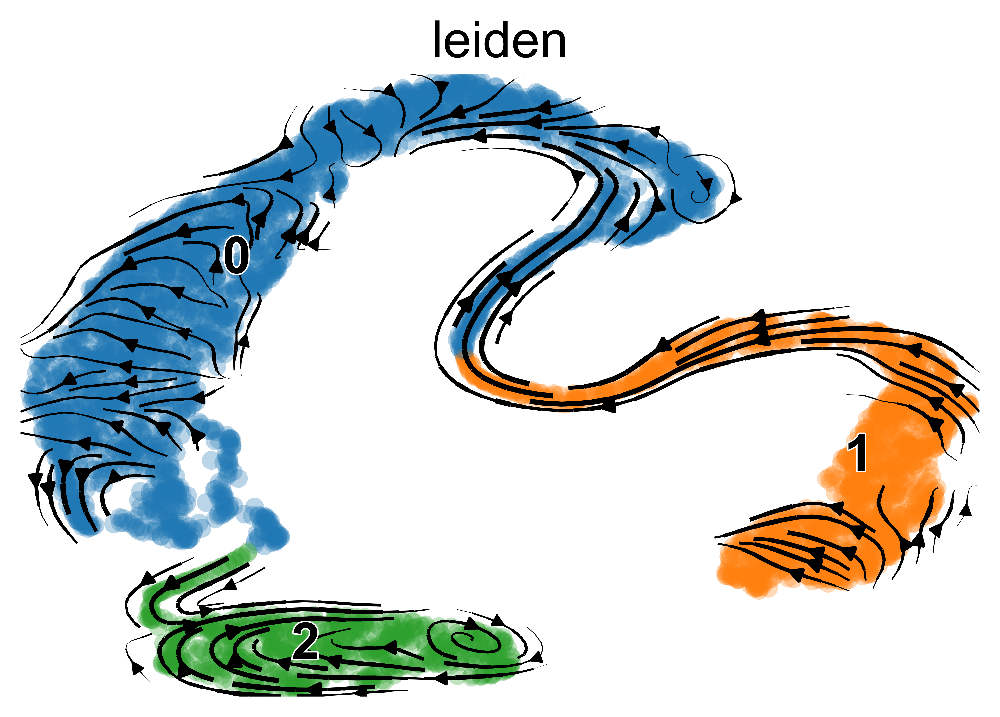

In [5]:
scv.set_figure_params(dpi =600,fontsize = 18)
scv.pl.velocity_embedding_stream(adata, basis='umap', color=['leiden'])

multi-stable attractors

In [5]:
scv.pp.moments(adata)
adata.obs['attractor'] = adata.obs['leiden'].values
adata_aggr = st.tl.dynamical_iteration(adata,n_states =3, n_iter = 15, weight_connectivities = 0.9, n_components = 21, n_neighbors = 100, thresh_ms_gene = 0.2, monitor_mode=True)

computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


  0%|          | 0/5000 [00:00<?, ?cell/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Fatal Python error: GC object already tracked

Thread 0x00007f4dd6ffd640 (most recent call first):
  File "/homeCaught signal number 13 Broken Pipe: Likely while reading or writing to a socket
/cliffzhou/miniconda3/envs/stt/l[0]PETSC ERROR: ib/python3Try option -start_in_debugger or -on_error_attach_debugger
.7/mul[0]PETSC ERROR: tiproor see https://petsc.org/release/faq/#valgrind
cessi[0]PETSC ERROR: ng/connor try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
ectio[0]PETSC ERROR: n.py"configure using --with-debugging=yes, recompile, link, and run 
, line 368 in [0]PETSC ERROR: _sendto get more information on the crash.

  File "/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/multiprocessing/connection.py", line 404 in _send_bytes
  File "/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/multiprocessing/connection.py", line 206 in send
  File "/

  0%|          | 0/5000 [00:00<?, ?cell/s]

((0.1 * <VelocityKernel[softmax_scale=185.07, mode=deterministic, seed=17624, scheme=<DotProductScheme>]>) + (0.9 * <ConnectivityKernel[dnorm=False, key=connectivities]>))


[0]PETSC ERROR: [0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 11 SEGV: Segmentation Violation, probably memory access out of range
free(): invalid pointer
[DESKTOP-07JEJMM:111643] *** Process received signal ***
[DESKTOP-07JEJMM:111643] Signal: Aborted (6)
[DESKTOP-07JEJMM:111643] Signal code:  (-6)



Quantiles for entropy relative difference with last iteration:
0.00   NaN
0.25   NaN
0.50   NaN
0.75   NaN
1.00   NaN
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    0.000015
0.25    0.000048
0.50    0.000346
0.75    0.002131
1.00    0.686065
dtype: float64

Quantiles for entropy absolute difference with last iteration:
Current values:
 weight_connectivities: 0.9, thresh_ms_gene: 0.2, spa_weight: 0.5


  0%|          | 0/5000 [00:00<?, ?cell/s]

[0]PETSC ERROR: 

  0%|          | 0/5000 [00:00<?, ?cell/s]

((0.1 * <VelocityKernel[softmax_scale=185.83, mode=deterministic, seed=59968, scheme=<DotProductScheme>]>) + (0.9 * <ConnectivityKernel[dnorm=False, key=connectivities]>))


[0]PETSC ERROR: 


Quantiles for entropy relative difference with last iteration:
0.00    0.000053
0.25    0.766787
0.50    0.806855
0.75    1.265245
1.00    1.666468
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    9.200675e-07
0.25    2.455686e-05
0.50    2.062463e-04
0.75    1.050711e-03
1.00    2.207280e-01
dtype: float64

Quantiles for entropy absolute difference with last iteration:
Current values:
 weight_connectivities: 0.9, thresh_ms_gene: 0.2, spa_weight: 0.5


  0%|          | 0/5000 [00:00<?, ?cell/s]

  0%|          | 0/5000 [00:00<?, ?cell/s]

((0.1 * <VelocityKernel[softmax_scale=186.43, mode=deterministic, seed=64048, scheme=<DotProductScheme>]>) + (0.9 * <ConnectivityKernel[dnorm=False, key=connectivities]>))


[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 11 SEGV: Segmentation Violation, probably memory access out of range
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: 


Quantiles for entropy relative difference with last iteration:
0.00    0.000004
0.25    0.086902
0.50    1.692562
0.75    1.758600
1.00    2.337043
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    2.409068e-08
0.25    3.420545e-06
0.50    6.737634e-04
0.75    3.979935e-03
1.00    3.529460e-01
dtype: float64

Quantiles for entropy absolute difference with last iteration:
Current values:
 weight_connectivities: 0.9, thresh_ms_gene: 0.2, spa_weight: 0.5


  0%|          | 0/5000 [00:00<?, ?cell/s]

  0%|          | 0/5000 [00:00<?, ?cell/s]

((0.1 * <VelocityKernel[softmax_scale=186.19, mode=deterministic, seed=19410, scheme=<DotProductScheme>]>) + (0.9 * <ConnectivityKernel[dnorm=False, key=connectivities]>))

Quantiles for entropy relative difference with last iteration:
0.00    0.000016
0.25    2.473039
0.50    2.753746
0.75    3.441311
1.00    6.794958
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    1.140747e-07
0.25    2.438077e-04
0.50    2.873196e-03
0.75    1.687171e-02
1.00    5.699436e-01
dtype: float64

Quantiles for entropy absolute difference with last iteration:
Current values:
 weight_connectivities: 0.9, thresh_ms_gene: 0.2, spa_weight: 0.5


  0%|          | 0/5000 [00:00<?, ?cell/s]

  0%|          | 0/5000 [00:00<?, ?cell/s]

((0.1 * <VelocityKernel[softmax_scale=172.09, mode=deterministic, seed=62861, scheme=<DotProductScheme>]>) + (0.9 * <ConnectivityKernel[dnorm=False, key=connectivities]>))


[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 11 SEGV: Segmentation Violation, probably memory access out of range
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.



Quantiles for entropy relative difference with last iteration:
0.00     0.000189
0.25     1.847509
0.50     1.924105
0.75     2.196565
1.00    12.955393
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    0.000033
0.25    0.000519
0.50    0.006649
0.75    0.046596
1.00    0.499647
dtype: float64

Quantiles for entropy absolute difference with last iteration:
Current values:
 weight_connectivities: 0.9, thresh_ms_gene: 0.2, spa_weight: 0.5


  0%|          | 0/5000 [00:00<?, ?cell/s]

  0%|          | 0/5000 [00:00<?, ?cell/s]

((0.2 * <VelocityKernel[softmax_scale=171.7, mode=deterministic, seed=4104, scheme=<DotProductScheme>]>) + (0.8 * <ConnectivityKernel[dnorm=False, key=connectivities]>))


[0]PETSC ERROR: 


Quantiles for entropy relative difference with last iteration:
0.00    0.000542
0.25    0.649291
0.50    0.763793
0.75    0.795882
1.00    1.287295
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    0.000147
0.25    0.000636
0.50    0.008636
0.75    0.026654
1.00    0.660285
dtype: float64

Quantiles for entropy absolute difference with last iteration:
Current values:
 weight_connectivities: 0.8, thresh_ms_gene: 0.2, spa_weight: 0.5


  0%|          | 0/5000 [00:00<?, ?cell/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 11 SEGV: Segmentation Violation, probably memory access out of range


  0%|          | 0/5000 [00:00<?, ?cell/s]

((0.3 * <VelocityKernel[softmax_scale=158.65, mode=deterministic, seed=14597, scheme=<DotProductScheme>]>) + (0.7 * <ConnectivityKernel[dnorm=False, key=connectivities]>))


/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/pygpcca/_gpcca.py:1274: UserWarning: Stationary distribution couldn't be calculated. Reason: This matrix is reducible. The second largest eigenvalue is (0.9999999999999939+0j)..
  warnings.warn(f"Stationary distribution couldn't be calculated. Reason: {e}.")


AttributeError: 'NoneType' object has no attribute 'to_numpy'

In [23]:
sc.pp.neighbors(adata_aggr)
sc.tl.umap(adata_aggr)

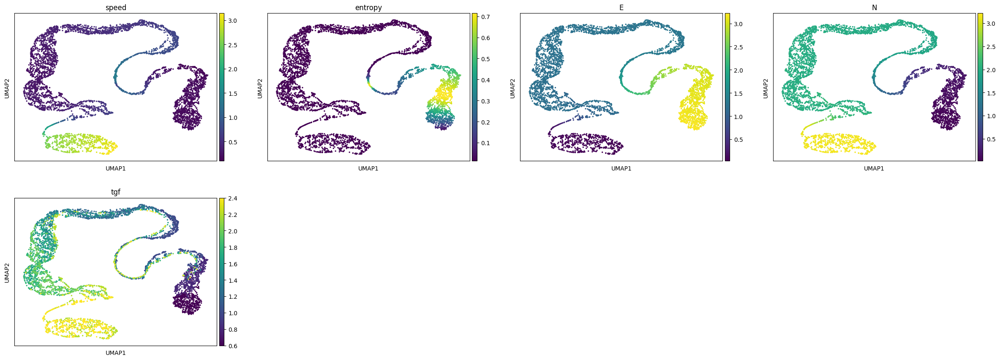

In [24]:
adata_aggr.obs['tgf']=adata.obs['tgf'].values
sc.pl.umap(adata_aggr,color = ['speed','entropy','E','N','tgf'])

or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 1/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: [0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 11 SEGV: Segmentation V

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


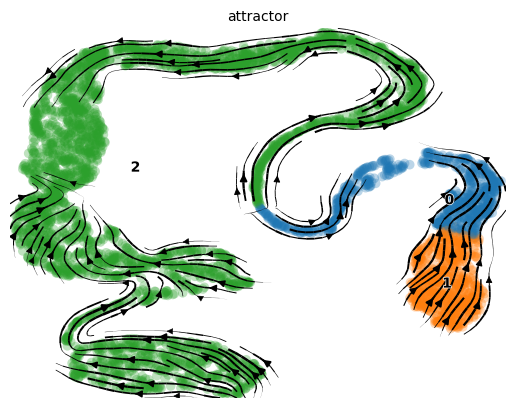

In [25]:
scv.tl.velocity_graph(adata_aggr)
scv.pl.velocity_embedding_stream(adata_aggr, basis='umap', color='attractor')

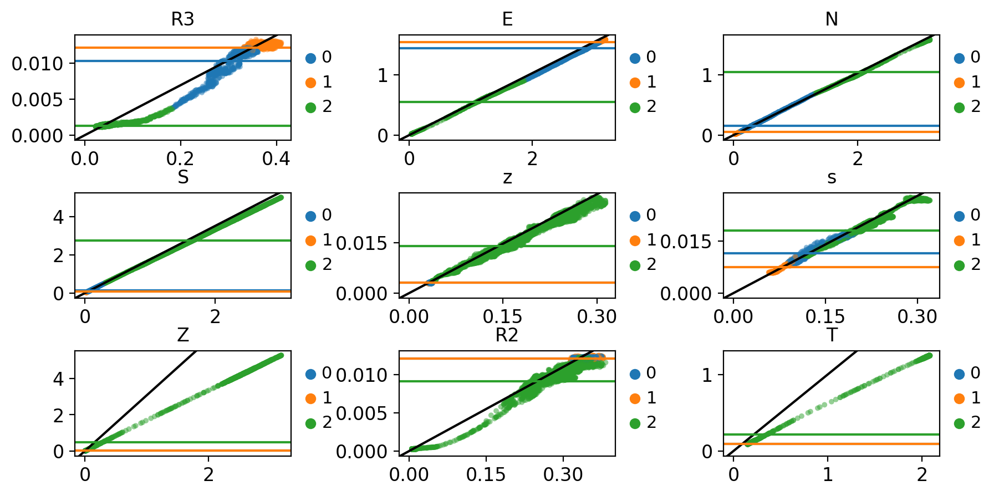

In [26]:
scv.set_figure_params(fontsize = 12)
st.pl.plot_top_genes(adata, ncols=3,figsize = (10,5),wspace = 0.5, top_genes=9)

In [14]:
sc.set_figure_params(dpi=600,fontsize = 10)
import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
adata.obsm['X_umap_aggr']=adata_aggr.obsm['X_umap']
st.pl.plot_tensor(adata, adata_aggr, basis = 'umap')

View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: [0]PETSC ERROR: ------------------------------------------------------------------------


    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
realloc(): invalid pointer
[DES

    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:02) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: [0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind
[0]PETSC ERROR: or try http://valgrind.org on GNU/linux and Apple MacOS to find memory corruption errors
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.


    finished (0:00:01) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: 

    finished (0:00:01) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: 

    finished (0:00:02) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: [0]PETSC ERROR: ------------------------------------------------------------------------
------------------------------------------------------------------------
[0]PETSC ERROR: Fatal Python error: GC object already tracked

Current thread 0x00007f47ceffd640 (most recent call first):
  File "/home/cliffzCaught signal number 11 SEGV: Segmentation Violation, probably memory access out of range
hou/miniconda[0]PETSC ERROR: 3/envTry option -start_in_debugger or -on_error_attach_debugger
s/s[0]PETSC ERROR: tt/lor see https://petsc.org/release/faq/#valgrind
ib/p[0]PETSC ERROR: 

    finished (0:00:01) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
View of AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'
computing velocity graph (using 32/32 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/home/cliffzhou/miniconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: ------------------------------------------------------------------------


    finished (0:00:02) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)


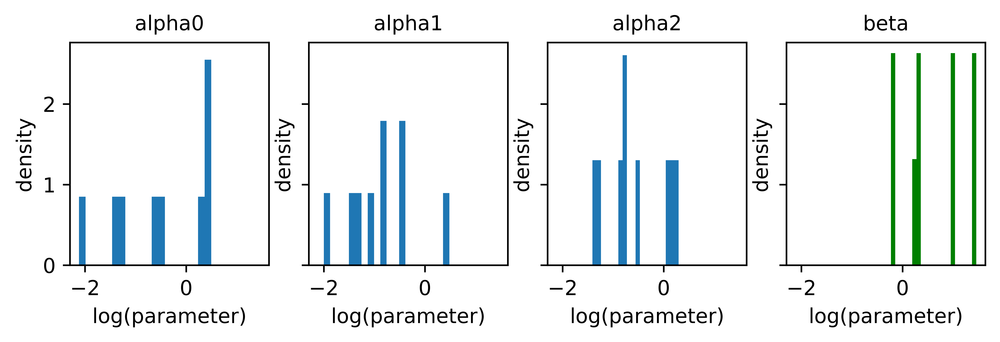

In [15]:
st.pl.plot_para_hist(adata,figsize=(8,2))

In [16]:
adata.var

,highly_variable,velocity_gamma,r2_train,r2_test
T,True,1.0,0.987408,0.979911
s,True,1.0,0.878751,0.883067
S,True,1.0,0.929246,0.931539
R3,True,1.0,0.959380,0.961229
z,True,1.0,0.896324,0.899095
Z,True,1.0,0.980278,0.971465
R2,True,1.0,0.941629,0.942086
E,True,1.0,0.984938,0.984875
N,True,1.0,0.984871,0.984820


In [17]:
adata

AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden', 'attractor', 'entropy', 'speed'
    var: 'highly_variable', 'velocity_gamma', 'r2_train', 'r2_test'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap', 'da_out', 'par', 'r2_keep_train', 'r2_keep_test', 'gene_subset', 'attractor_colors'
    obsm: 'X_umap', 'tensor_v', 'tensor_v_aver', 'rho', 'X_umap_aggr'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velo'
    obsp: 'connectivities', 'distances'